# TF Instance Segmentation and Dominant Colors of Kimonos

**AUTHOR: CAMELIA CIOLAC**   
ciolac_c@inria-alumni.fr


In this mini-project we use pretrained MASK R-CNN model with Tensorflow to detect people, who in these thematic photos are wearing traditional Japanese kimonos. 
These segmented kimonos are post-processed for dominant color palette.

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [ ]:
from IPython.core.display import display, HTML
#display(HTML("<style>.container { width:100% !important; }</style>"))

import matplotlib as mpl
from matplotlib.pyplot import imshow
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
from matplotlib.patches import Rectangle, Circle
from matplotlib.offsetbox import TextArea, DrawingArea, OffsetImage, AnnotationBbox
from mpl_toolkits import mplot3d

from mpl_toolkits.axes_grid1 import make_axes_locatable

import seaborn as sns
%matplotlib inline

In [ ]:
!mkdir -p "/content/gdrive/My Drive/kimono"

In [ ]:
!sudo apt-get install tree > /dev/null 2>&1
!pip install colorthief
!echo "----------------------------------------------------------------------"
!pip install hdbscan

----------------------------------------------------------------------
     |████████████████████████████████| 4.7MB 12.3MB/s 
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
    Preparing wheel metadata ... done
  Created wheel for hdbscan: filename=hdbscan-0.8.26-cp36-cp36m-linux_x86_64.whl size=2301799 sha256=8f52c257492926d0a444460800146d806019ff292d45b2c4301b63758076ab57
  Stored in directory: /root/.cache/pip/wheels/82/38/41/372f034d8abd271ef7787a681e0a47fc05d472683a7eb088ed
Successfully built hdbscan


In [ ]:
import pandas as pd
import numpy as np
import math
from scipy.spatial import distance

import hdbscan


from PIL import Image as pilim
import collections

import pprint

import os
import glob

import requests as req

from colorthief import ColorThief

import cv2
cv2.__version__

'4.1.2'

In [ ]:
import os
#logging levels : 0 = INFO , 1 = WARN , 2 = ERROR, 3 = none (not used in TF2)
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '2' 

import tensorflow as tf
from tensorflow.python.lib.io import file_io
import tensorflow_hub as hub
print("TF version:", tf.__version__)

#logging level for TF2
tf.get_logger().setLevel('ERROR')

#devices discovered by TF2
physical_devices = tf.config.list_physical_devices()
for pdev in physical_devices:
  print(pdev)

TF version: 2.3.0
PhysicalDevice(name='/physical_device:CPU:0', device_type='CPU')
PhysicalDevice(name='/physical_device:XLA_CPU:0', device_type='XLA_CPU')
PhysicalDevice(name='/physical_device:XLA_GPU:0', device_type='XLA_GPU')
PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')


In [ ]:
#GPU info - NVIDIA System Management Interface
!nvidia-smi 

Wed Nov 25 09:25:34 2020       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 455.38       Driver Version: 418.67       CUDA Version: 10.1     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   45C    P8     9W /  70W |     10MiB / 15079MiB |      0%      Default |
|                               |                      |                 ERR! |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [ ]:
import warnings

with warnings.catch_warnings():
    warnings.filterwarnings("ignore",category=DeprecationWarning)
    warnings.filterwarnings("ignore",category= mpl.cbook.MatplotlibDeprecationWarning)

## Download a set of images

To better focus on traditional kimonos, we employ as search terms the Japanese writing as in [1] and [2].

[1] https://en.wikipedia.org/wiki/Kimono  
[2] https://wattention.com/know-different-kimono-types/

In [ ]:
FOLDER_IMAGES = "/content/gdrive/My Drive/kimono/"

In [ ]:
list_urls = [ "https://moonsally.com/wp-content/uploads/20170522114356_95.jpg",
              "https://i.pinimg.com/originals/5c/62/be/5c62bef7346f078da2f52439afeb7a27.jpg",
              "https://www.madornomad.com/wp-content/uploads/2019/09/japan-tea-5-1024x683.jpg",   
              "https://juliepodstolski.files.wordpress.com/2014/10/step-by-step-small-size.jpg",
              "https://nihongogo.com/wordpress/wp-content/uploads/2015/01/The-Girls-of-Nogizaka46-Celebrate-Their-Coming-Of-Age-Ceremony-620x400.jpg",                   
              "https://data.tokyogirlsupdate.com/wp/wp-content/uploads/2015/01/img_AKB48_20150111_01.jpg",
              "https://miro.medium.com/max/1200/1*wp_R8iqWLytnVKvIKDK4pA.jpeg",                 
              "https://www.hotelgajoen-tokyo.com/wp/wp-content/uploads/2019/09/kyoodori2020.jpg",
              "http://www.kikuya-komai.com/wordpress/wp-content/uploads/2017/04/061fc1b6644ddf9ec40fd3c5cffe4ef3.jpg",
              "https://i1.wp.com/mykyotophoto.com/wp-content/uploads/2018/01/180113_Kyoto-Gion-Hatsuyori-Geisha-Maiko-857219.jpg",
              "https://www.tokyoweekender.com/wp-content/uploads/2020/01/Kyoto-Geisha-Tokyo-Weekender-performance-1100x825.jpg",
              "https://rimage.gnst.jp/livejapan.com/public/img/spot/lj/00/12/lj0012616/lj0012616_5da8298d8ead6_main.jpg"                         
            ]


for ii,url_ in enumerate(list_urls):
    resp = req.get(url = url_)
    if resp.status_code == 200:
        img_filepath = FOLDER_IMAGES + ("kimono{}.jpg".format(ii+1))
        with open(img_filepath, 'wb') as out_file:
            out_file.write(resp.content)
        del resp


In [ ]:
def visualize_sample_images(num_images_to_visualize, target_folder):

    num_cols_plot = 4
    num_rows_plot = math.ceil(num_images_to_visualize/num_cols_plot)

    fig = plt.figure(figsize=(num_cols_plot * 5, num_rows_plot * 5))

    list_jpgfiles = glob.glob(target_folder + '/*.jpg')
    #sample without replacement
    list_jpgfiles_sample = np.random.choice(np.array(list_jpgfiles), 
                                            size = num_images_to_visualize,
                                            replace=False)

    for ii in range(num_images_to_visualize):
        ax = fig.add_subplot(num_rows_plot, num_cols_plot,ii+1)
        jpgfile = list_jpgfiles_sample[ii]
        im = pilim.open(jpgfile)
        ax.imshow(im)

    fig.tight_layout()
    return list_jpgfiles_sample

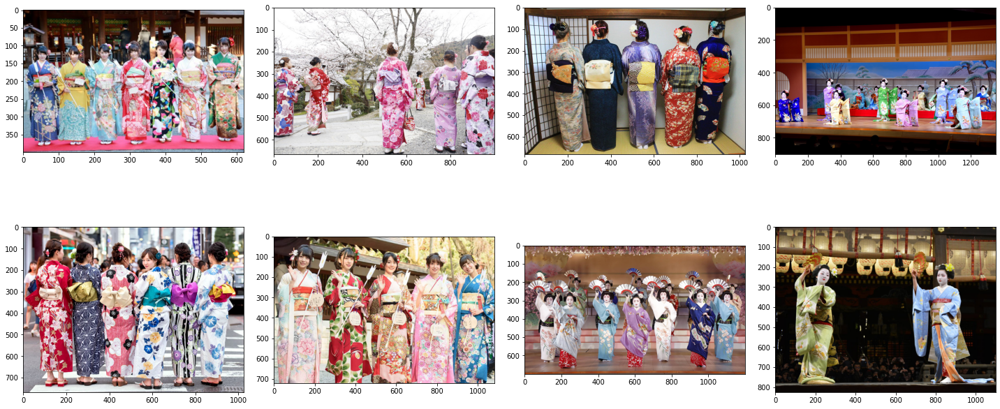

In [ ]:
list_jpgfiles_sample = visualize_sample_images(num_images_to_visualize = 8 , 
                                               target_folder = "/content/gdrive/My Drive/kimono")

In [ ]:
list_jpgfiles_sample

array(['/content/gdrive/My Drive/kimono/kimono5.jpg',
       '/content/gdrive/My Drive/kimono/kimono1.jpg',
       '/content/gdrive/My Drive/kimono/kimono3.jpg',
       '/content/gdrive/My Drive/kimono/kimono9.jpg',
       '/content/gdrive/My Drive/kimono/kimono2.jpg',
       '/content/gdrive/My Drive/kimono/kimono7.jpg',
       '/content/gdrive/My Drive/kimono/kimono8.jpg',
       '/content/gdrive/My Drive/kimono/kimono11.jpg'], dtype='<U44')

## Download pretrained MASK R-CNN Tensorflow model

Mask R-CNN Object detection model,trained on COCO 2017 dataset - https://tfhub.dev/tensorflow/mask_rcnn/inception_resnet_v2_1024x1024/1

We download it directly as "tar.gz" archive and cache it locally :


In [ ]:
!wget --spider https://tfhub.dev/tensorflow/mask_rcnn/inception_resnet_v2_1024x1024/1?tf-hub-format=compressed

Spider mode enabled. Check if remote file exists.
--2020-11-25 09:33:35--  https://tfhub.dev/tensorflow/mask_rcnn/inception_resnet_v2_1024x1024/1?tf-hub-format=compressed
Resolving tfhub.dev (tfhub.dev)... 172.217.7.174, 2607:f8b0:4004:800::200e
Connecting to tfhub.dev (tfhub.dev)|172.217.7.174|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://storage.googleapis.com/tfhub-modules/tensorflow/mask_rcnn/inception_resnet_v2_1024x1024/1.tar.gz [following]
Spider mode enabled. Check if remote file exists.
--2020-11-25 09:33:35--  https://storage.googleapis.com/tfhub-modules/tensorflow/mask_rcnn/inception_resnet_v2_1024x1024/1.tar.gz
Resolving storage.googleapis.com (storage.googleapis.com)... 172.217.7.240, 172.217.13.80, 172.217.13.240, ...
Connecting to storage.googleapis.com (storage.googleapis.com)|172.217.7.240|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 242869606 (232M) [application/octet-stream]
Remote file exists.



In [ ]:
!mkdir -p /tmp/tfhub_models/mask_rcnn
!curl -L "https://tfhub.dev/tensorflow/mask_rcnn/inception_resnet_v2_1024x1024/1?tf-hub-format=compressed" | tar -zxvC /tmp/tfhub_models/mask_rcnn

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
  0     0    0     0    0     0      0      0 --:--:-- --:--:-- --:--:--     0
./
./saved_model.pb
./variables/
./variables/variables.data-00000-of-00001
100  231M  100  231M    0     0  25.9M      0  0:00:08  0:00:08 --:--:-- 27.5M
./variables/variables.index


In [ ]:
!tree --du -h  /tmp/tfhub_models

/tmp/tfhub_models
└── [264M]  mask_rcnn
    ├── [ 16M]  saved_model.pb
    └── [248M]  variables
        ├── [248M]  variables.data-00000-of-00001
        └── [ 15K]  variables.index

 264M used in 2 directories, 3 files


## Read image:

In [ ]:
def get_image(file_path):
    """ read image from specified location, which can be the 
        local filesystem path or a GCP Storage blob URI"""
    with file_io.FileIO(file_path, 'rb') as f:
        im = tf.io.decode_image(f.read())
        #since we're in eager execution mode in TF, we can easily convert tensor to numpy
        im_arr = im.numpy()
    return im, im_arr

In [ ]:
FOLDER_IMAGES = "/content/gdrive/My Drive/kimono/"

In [ ]:
im1_tens, im1_arr = get_image(file_path = FOLDER_IMAGES + "kimono1.jpg")
print("im_tens:".ljust(20), im1_tens.shape, im1_tens.dtype, type(im1_tens))
print("im_arr:".ljust(20), im1_arr.shape, im1_arr.dtype, type(im1_arr))

#input needs to be tensor and we need to expand dims
batch_tens_inp = tf.expand_dims(im1_tens, 0)
print("batch_tens_inp:".ljust(20), batch_tens_inp.shape, batch_tens_inp.dtype)

im_tens:             (667, 1000, 3) <dtype: 'uint8'> <class 'tensorflow.python.framework.ops.EagerTensor'>
im_arr:              (667, 1000, 3) uint8 <class 'numpy.ndarray'>
batch_tens_inp:      (1, 667, 1000, 3) <dtype: 'uint8'>


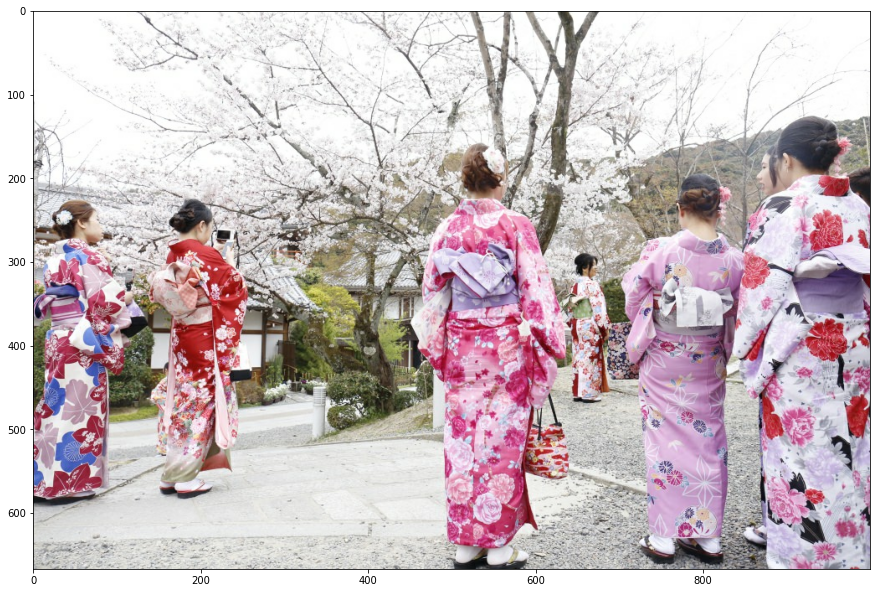

In [ ]:
fig, ax = plt.subplots(1,1,  figsize=(15,15))
ax.imshow(im1_arr)

Sidenote about the patterns on the kimonos in the picture. Quote from [3]:

>  "When it comes to patterns, cherry blossom is a good example of the rules; one may wear cherry blossom just before the trees flower but, once the trees are in bloom, one should not wear it anymore but one can then wear falling cherry blossom petals design, until the petals do start to fall, then one should stop wearing any cherry blossom pattern until the following year, shortly before the trees bloom again."

[3] https://wafuku.wordpress.com/2011/05/15/japanese-colour-names-seasonal-combinations/

## Inference with the pretrained MASK R-CNN model

### Load the SavedModel:

In [ ]:
mask_rcnn_model = hub.load("/tmp/tfhub_models/mask_rcnn")

### Inspect the model's inputs and outputs:

In [ ]:
mask_rcnn_model.signatures

_SignatureMap({'serving_default': <ConcreteFunction signature_wrapper(input_tensor) at 0x7FCEC1677FD0>})

In [ ]:
mask_rcnn_model_func = mask_rcnn_model.signatures["serving_default"]

print(type(mask_rcnn_model_func))

print("========================================================================")

#we can see here as well the input(s) and output(s)  of the saved model
print("INPUTS:")
print("===========")
#pprint.pprint(mask_rcnn_model_func.inputs)
pprint.pprint(mask_rcnn_model_func.structured_input_signature)
print("-----------------------------------------------------------------")
print("OUTPUTS:")
print("===========")
pprint.pprint(mask_rcnn_model_func.outputs)
pprint.pprint(mask_rcnn_model_func.structured_outputs)

<class 'tensorflow.python.saved_model.load._WrapperFunction'>
INPUTS:
((),
 {'input_tensor': TensorSpec(shape=(1, None, None, 3), dtype=tf.uint8, name='input_tensor')})
-----------------------------------------------------------------
OUTPUTS:
[<tf.Tensor 'Identity:0' shape=(None, 4) dtype=float32>,
 <tf.Tensor 'Identity_1:0' shape=(300, 9, 9, 1536) dtype=float32>,
 <tf.Tensor 'Identity_2:0' shape=(300, 91) dtype=float32>,
 <tf.Tensor 'Identity_3:0' shape=(1, 100) dtype=float32>,
 <tf.Tensor 'Identity_4:0' shape=(1, 100, 4) dtype=float32>,
 <tf.Tensor 'Identity_5:0' shape=(1, 100) dtype=float32>,
 <tf.Tensor 'Identity_6:0' shape=(1, 100, 33, 33) dtype=float32>,
 <tf.Tensor 'Identity_7:0' shape=(1, 100, 91) dtype=float32>,
 <tf.Tensor 'Identity_8:0' shape=(1, 100) dtype=float32>,
 <tf.Tensor 'Identity_9:0' shape=(1, 300, 4) dtype=float32>,
 <tf.Tensor 'Identity_10:0' shape=(4,) dtype=float32>,
 <tf.Tensor 'Identity_11:0' shape=(100, 90, 33, 33) dtype=float32>,
 <tf.Tensor 'Identity_12:0

### Make prediction:

In [ ]:
%%time
#on gpu - with warmup delay
res_mask_rcnn = mask_rcnn_model_func(batch_tens_inp)

CPU times: user 7.79 s, sys: 2.9 s, total: 10.7 s
Wall time: 15.2 s


In [ ]:
%%time
#on gpu (explicitly placed computation on device)

with tf.device('/gpu:0'):
    res_mask_rcnn__ = mask_rcnn_model_func(batch_tens_inp)

CPU times: user 369 ms, sys: 25.4 ms, total: 394 ms
Wall time: 623 ms


In [ ]:
%%time
#force to execute on cpu

with tf.device('/cpu:0'):
    res_mask_rcnn___ = mask_rcnn_model_func(batch_tens_inp)

CPU times: user 1min 49s, sys: 1.47 s, total: 1min 50s
Wall time: 58.2 s


In [ ]:
print("num_detections    ==>", res_mask_rcnn["num_detections"], "objects detected")
print("-----------------------------------------")
print("detection_scores  ==>", res_mask_rcnn["detection_scores"].shape)
print(res_mask_rcnn["detection_scores"])

print("-----------------------------------------")
print("detection_classes ==>", res_mask_rcnn["detection_classes"].shape, res_mask_rcnn["detection_classes"].dtype)
print(res_mask_rcnn["detection_classes"])

print("-----------------------------------------")
print("detection_boxes ==>", res_mask_rcnn["detection_boxes"].shape)
print("one entity's bbox (float values are ratios of the images width and heigth):")
#the first [0] is for taking the first image's result of the batch, the second [0] is to take only one detected entity
print(res_mask_rcnn["detection_boxes"][0][0])

print("-----------------------------------------")
print("detection_masks ==>", res_mask_rcnn["detection_masks"].shape)


num_detections    ==> tf.Tensor([100.], shape=(1,), dtype=float32) objects detected
-----------------------------------------
detection_scores  ==> (1, 100)
tf.Tensor(
[[0.9997465  0.9992118  0.99871194 0.99839383 0.9849065  0.9667908
  0.9360277  0.26477307 0.25115067 0.16977355 0.02673861 0.0260255
  0.0217981  0.0195893  0.01916745 0.0182702  0.01642814 0.0159377
  0.01580819 0.01562024 0.01529302 0.01348602 0.01253263 0.01229722
  0.01201196 0.01137224 0.01130698 0.01092886 0.01016534 0.00986816
  0.00980658 0.00882746 0.00857712 0.00851114 0.00798996 0.00762197
  0.00688301 0.00681056 0.00664345 0.00656144 0.00655849 0.00638488
  0.00628396 0.00605576 0.00573315 0.00529702 0.00511492 0.0049978
  0.00496791 0.00490523 0.00489408 0.00483439 0.00462761 0.00425298
  0.00419019 0.00413352 0.0040997  0.00409659 0.0039188  0.00357561
  0.00350034 0.00347923 0.00344806 0.00331262 0.00318456 0.00314453
  0.00308315 0.00304514 0.00298609 0.00292026 0.00285187 0.00284799
  0.00284083 0.00261

## Postprocess inference results

### Filter results based on prediction scores

The entities detected (based on the COCO 2017 dataset classes, are sorted in descending order of their confidence score (see detection_score above). We need to set a threshold and accept only entities with score above it.

In [ ]:
def filter_confident_results(res_mask_rcnn, threshold_score = 0.5):
    """given a prediction result in res_mask_rcnn, apply threshold to retain only 
       detected entities with higher confidence score"""

    res_mask_rcnn_confident = {}
    list_scores = list(res_mask_rcnn["detection_scores"].numpy().flatten())
    list_classes = list(res_mask_rcnn["detection_classes"].numpy().flatten())

    list_indices_confident = [ii for ii in range(len(list_scores)) if list_scores[ii] >= threshold_score]

    #tf_gather - see https://www.tensorflow.org/api_docs/python/tf/gather
    #we specify axis = 1 because the 0-axis corresponds to the batch
    res_mask_rcnn_confident["detection_scores"] = tf.gather(res_mask_rcnn["detection_scores"], list_indices_confident, axis = 1)
    res_mask_rcnn_confident["detection_classes"] = tf.gather(res_mask_rcnn["detection_classes"], list_indices_confident, axis = 1)
    res_mask_rcnn_confident["detection_boxes"] = tf.gather(res_mask_rcnn["detection_boxes"], list_indices_confident, axis = 1)
    res_mask_rcnn_confident["detection_masks"] = tf.gather(res_mask_rcnn["detection_masks"], list_indices_confident, axis = 1)
    res_mask_rcnn_confident["num_detections"] = res_mask_rcnn_confident["detection_scores"].shape[1]

    return res_mask_rcnn_confident

In [ ]:
res_mask_rcnn_confident = filter_confident_results(res_mask_rcnn, threshold_score = 0.5)

print("num_detections    ==>", res_mask_rcnn_confident["num_detections"], "objects detected")
print("-----------------------------------------")
print(res_mask_rcnn_confident["detection_scores"])
list_scores_confident = list(res_mask_rcnn_confident["detection_scores"].numpy().flatten())

print("-----------------------------------------")
print(res_mask_rcnn_confident["detection_classes"])
list_classes_confident = list(res_mask_rcnn_confident["detection_classes"].numpy().flatten())


num_detections    ==> 7 objects detected
-----------------------------------------
tf.Tensor(
[[0.9997465  0.9992118  0.99871194 0.99839383 0.9849065  0.9667908
  0.9360277 ]], shape=(1, 7), dtype=float32)
-----------------------------------------
tf.Tensor([[ 1.  1.  1.  1. 31.  1.  1.]], shape=(1, 7), dtype=float32)


### Decode numeric labels to textual labels

In [ ]:
!wget --quiet https://raw.githubusercontent.com/tensorflow/models/master/research/object_detection/data/mscoco_label_map.pbtxt
!head -n 10 mscoco_label_map.pbtxt

item {
  name: "/m/01g317"
  id: 1
  display_name: "person"
}
item {
  name: "/m/0199g"
  id: 2
  display_name: "bicycle"
}


In [ ]:
with open('mscoco_label_map.pbtxt') as f:
    lines = f.readlines()

lines[0:10]

['item {\n',
 '  name: "/m/01g317"\n',
 '  id: 1\n',
 '  display_name: "person"\n',
 '}\n',
 'item {\n',
 '  name: "/m/0199g"\n',
 '  id: 2\n',
 '  display_name: "bicycle"\n',
 '}\n']

In [ ]:
#we use list comprehension to extract the useful parts from each group of 5 lines that form an "item" 
list_dict_labels = [{"label_id": int(str(lines[5*ii + 2]).replace('"','').split(":")[1].strip()),
                     "label_name": str(lines[5*ii + 3]).replace('"','').split(":")[1].strip()} for ii in range(len(lines)//5)]
list_dict_labels[0:10]

[{'label_id': 1, 'label_name': 'person'},
 {'label_id': 2, 'label_name': 'bicycle'},
 {'label_id': 3, 'label_name': 'car'},
 {'label_id': 4, 'label_name': 'motorcycle'},
 {'label_id': 5, 'label_name': 'airplane'},
 {'label_id': 6, 'label_name': 'bus'},
 {'label_id': 7, 'label_name': 'train'},
 {'label_id': 8, 'label_name': 'truck'},
 {'label_id': 9, 'label_name': 'boat'},
 {'label_id': 10, 'label_name': 'traffic light'}]

In [ ]:
#make dataframe
df_coco = pd.DataFrame(list_dict_labels)
print(df_coco.shape)

df_coco.head()

(80, 2)


,label_id,label_name
0,1,person
1,2,bicycle
2,3,car
3,4,motorcycle
4,5,airplane


In [ ]:
dict_decode_coco = dict(zip(df_coco["label_id"], df_coco["label_name"]))

In [ ]:
#for our result 
print("Initially (unfiltered)")
list_classes = list(res_mask_rcnn["detection_classes"].numpy().flatten())
c = collections.Counter(list_classes)
print(c)

list_classes_textual = [dict_decode_coco[el] for el in list_classes]
c2 = collections.Counter(list_classes_textual)
print(c2)

print("------------------------------------------------------------")

print("Finally (filtered)")
c3 = collections.Counter(list_classes_confident)
print(c3)

list_classes_confident_textual = [dict_decode_coco[el] for el in list_classes_confident]
c4 = collections.Counter(list_classes_confident_textual)
print(c4)

Initially (unfiltered)
Counter({1.0: 36, 31.0: 30, 27.0: 11, 3.0: 3, 40.0: 2, 77.0: 2, 34.0: 2, 88.0: 2, 36.0: 2, 43.0: 1, 62.0: 1, 21.0: 1, 15.0: 1, 32.0: 1, 22.0: 1, 2.0: 1, 41.0: 1, 11.0: 1, 44.0: 1})
Counter({'person': 36, 'handbag': 30, 'backpack': 11, 'car': 3, 'baseball glove': 2, 'cell phone': 2, 'frisbee': 2, 'teddy bear': 2, 'snowboard': 2, 'tennis racket': 1, 'chair': 1, 'cow': 1, 'bench': 1, 'tie': 1, 'elephant': 1, 'bicycle': 1, 'skateboard': 1, 'fire hydrant': 1, 'bottle': 1})
------------------------------------------------------------
Finally (filtered)
Counter({1.0: 6, 31.0: 1})
Counter({'person': 6, 'handbag': 1})


----------------

### Summarize inference pipeline 


In [ ]:
def make_confident_prediction(img_filename):
    """read image from img_filename, make a batch and perform inference, filtering detected objects 
       based on entity-level confidence score """

    im1_tens, im1_arr = get_image(file_path = FOLDER_IMAGES + img_filename)
    #input needs to be tensor and we need to expand dims
    batch_tens_inp = tf.expand_dims(im1_tens, 0)
    #make prediction
    res_mask_rcnn = mask_rcnn_model_func(batch_tens_inp)
    #filter based on confidence scores
    res_mask_rcnn_confident = filter_confident_results(res_mask_rcnn, threshold_score = 0.5)

    return res_mask_rcnn_confident, im1_arr

In [ ]:
res_mask_rcnn_confident, im1_arr = make_confident_prediction(img_filename = "kimono1.jpg")

### Original image cuts based on inference masks

In [ ]:
def postprocess_inference_result(res_mask_rcnn_confident, im1_arr):
    """Post-process the inference result to extract an array of cuts from the original image"""
    
    list_cuts_original = []

    #tuple unpacking
    im1_height, im1_width = im1_arr.shape[0], im1_arr.shape[1]

    #take [0] because we wrapped the image in a batch
    bbox_arr = res_mask_rcnn_confident["detection_boxes"][0].numpy()
    segmask_arr = res_mask_rcnn_confident["detection_masks"][0].numpy()
    label_arr = res_mask_rcnn_confident["detection_classes"][0].numpy()

    for ii in range(res_mask_rcnn_confident["num_detections"]):
        bbox_entity = bbox_arr[ii]
        segmask_entity = segmask_arr[ii]
        label_entity = label_arr[ii]

        if dict_decode_coco[label_entity] == "person":
            dict_one_cut_original  = {}

            #make coords absolute value
            bbox_entity_absolute = [bbox_entity[0] * im1_height, 
                                    bbox_entity[1] * im1_width,
                                    bbox_entity[2] * im1_height, 
                                    bbox_entity[3] * im1_width,
                                ] 
            bbox_entity_absolute = np.int64(bbox_entity_absolute)
            ymin, xmin, ymax, xmax = bbox_entity_absolute 
            bbox_width = xmax - xmin
            bbox_height = ymax - ymin

            #filter out small instances in the background (note: ymax gives feet position )
            thresh_size_foreground = 0.2 * im1_height
            thresh_size_background = 0.5 * im1_height
            if ((ymax >= 0.75 * im1_height) and (bbox_height > thresh_size_foreground)) or \
               ((ymax < 0.75 * im1_height) and (bbox_height >= thresh_size_background)):

                #copy the bbox contents from the original image
                confidence_mask_pixels = np.array(
                        pilim.fromarray(np.uint8(segmask_entity * 255), mode='L')\
                            .resize(size=(bbox_width, bbox_height), resample=pilim.NEAREST)  
                    )
                #print("bbox_mask has values in range: [{},{}]".format(bbox_mask.min(), bbox_mask.max()))
                
                #bbox_mask has values in range [0,254] which stand for confidence that pixel is of this label
                #we need to apply threshold to convert to binary 
                thresh_confid_pixel = 70
                bbox_mask_binary = confidence_mask_pixels.copy()
                bbox_mask_binary[bbox_mask_binary < thresh_confid_pixel] = 0
                bbox_mask_binary[bbox_mask_binary >= thresh_confid_pixel] = 1
                
                #now use this binary matrix to extract original cuts
                original_bbox = im1_arr[ymin:ymax, xmin:xmax,:].copy()
                #original_bbox contains the bbox cut from the original image, but we want to black out the non-human pixels
                original_bbox[bbox_mask_binary == 0] = 0

                #compute contour around the human instance
                contour_candidates_list = cv2.findContours(bbox_mask_binary, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_NONE)[-2] 
                #take the contour with the largest area (after sorting in descending order by area)
                sorted_contour_candidates_list = sorted(contour_candidates_list, key = lambda x: cv2.contourArea(x), reverse = True)
                best_contour = sorted_contour_candidates_list[0]
                #polygonal approximation of the contour (see https://docs.opencv.org/3.1.0/dd/d49/tutorial_py_contour_features.html)
                epsilon = 0.0005 * cv2.arcLength(np.float32(best_contour),True)
                contour_polygon = cv2.approxPolyDP(best_contour, epsilon, True)
                #note: the result so far is [ [[x1  y1]] , [[x2 y2]] ,  [[x3 y3]], ... ], so we reshape it to  [ [x1  y1] , [x2 y2] ,  [x3 y3] ]
                contour_polygon_ = contour_polygon[:, 0, :]  

                dict_one_cut_original["bbox_entity_absolute"] = bbox_entity_absolute
                dict_one_cut_original["confidence_mask_pixels"] = confidence_mask_pixels
                dict_one_cut_original["original_bbox"] = original_bbox
                dict_one_cut_original["contour_polygon"] = contour_polygon_

                list_cuts_original.append(dict_one_cut_original)

    return list_cuts_original
          


In [ ]:
list_cuts_original = postprocess_inference_result(res_mask_rcnn_confident, im1_arr)

#example of one item in the list:

#temporary modify print options for np array
with np.printoptions(threshold=10):
    pprint.pprint(list_cuts_original[0])


{'bbox_entity_absolute': array([157, 456, 660, 643]),
 'confidence_mask_pixels': array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]], dtype=uint8),
 'contour_polygon': array([[74,  0],
       [74, 14],
       [73, 15],
       ...,
       [85, 15],
       [84, 14],
       [84,  0]], dtype=int32),
 'original_bbox': array([[[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       ...,

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

    

### Visualize predictions in terms of segmented masks:

In [ ]:
def debugged_visualization(list_cuts_original, im1_arr):
    "visualize the results of the inference, postprocessed"

    #make a copy of the originl image, that'll be modified by adding bboxes rectangles to it
    im1_arr_cpy = im1_arr.copy()
    #create a white background image with same shape as origina image
    im1_black_cpy = np.zeros_like(im1_arr[:,:,0])
    #create a white background image with same shape as origina image
    im1_white_cpy = 255 * np.zeros_like(im1_arr[:,:])

    fig,ax = plt.subplots(1,3,figsize=(30,15))

    for ii,dict_one_cut_original in enumerate(list_cuts_original):
        #tuple unpacking
        ymin, xmin, ymax, xmax = dict_one_cut_original["bbox_entity_absolute"]
        #---------------plot bboxes on figure on left side
        cv2.rectangle(img = im1_arr_cpy, 
                        pt1 = (xmin, ymin), pt2 = (xmax, ymax),
                        color = (0, 0, 255), thickness = 4
                        )
        #---------------plot polygons approximating contours on figure on left side
        contour_polygon_ = dict_one_cut_original['contour_polygon']
        #move it to the position of the bbox
        contour_polygon = contour_polygon_ + np.array([xmin, ymin])   
        polyg = plt.Polygon(contour_polygon, fill=None, edgecolor='blue', linewidth=4)
        ax[0].add_patch(polyg)
        #--------------plot segmented mask on the right side
        #note: when we place the bbox at its coords in the whole image, we might overlay it over other bboxes previously added
        im1_white_cpy[ymin:ymax, xmin:xmax] = dict_one_cut_original["original_bbox"]
        #on the heatmap, we can use add instead, and cap it at max 255
        im1_black_cpy[ymin:ymax, xmin:xmax] = np.add(im1_black_cpy[ymin:ymax, xmin:xmax], dict_one_cut_original["confidence_mask_pixels"])
        im1_black_cpy[ymin:ymax, xmin:xmax] = np.clip(im1_black_cpy[ymin:ymax, xmin:xmax], 0, 255)
       
            
    ax[0].imshow(im1_arr_cpy, alpha = 0.7)
    ax[1].imshow(im1_white_cpy)
    ax[2].imshow(im1_black_cpy, cmap = "plasma")
            
    fig.tight_layout()

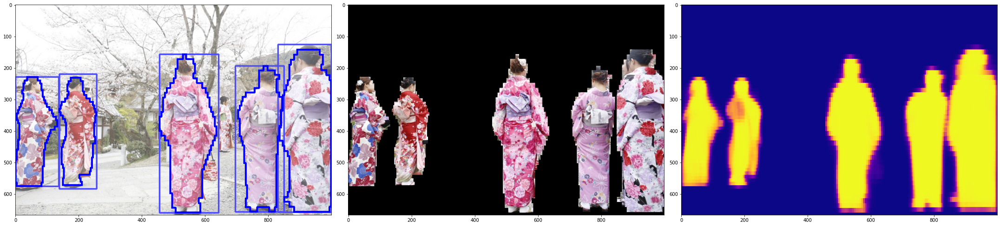

In [ ]:
debugged_visualization(list_cuts_original, im1_arr)

Remember, we get only these results because we set size threshold on bbox to have at least half of the original image height, when in the background

## Dominant colors in each kimono detected

It is interesting to read about the semantics of kimono chromatics, e.g. [3], [4]

[3] https://wafuku.wordpress.com/2011/05/15/japanese-colour-names-seasonal-combinations/  
[4] https://www.galeriemagazine.com/japanese-kimono-color-theory/  


### First approach - using ColorThief

In [ ]:
help(ColorThief.__init__)

Help on function __init__ in module colorthief:

__init__(self, file)
    Create one color thief for one image.
    
    :param file: A filename (string) or a file object. The file object
                 must implement `read()`, `seek()`, and `tell()` methods,
                 and be opened in binary mode.



Note: the python package has class ColorThief which oonly accepts a file name as parameter to its constructor, which is a bit inconvenient for our case. If we inspect its source code in Github (https://github.com/fengsp/color-thief-py/blob/master/colorthief.py), the constructor only opens the file with PIL, so we can extend this class and overload the construtor:

In [ ]:
class ModifiedColorThief(ColorThief):
    def __init__(self, np_array:np.array):
        #print("overloaded constructor")
        self.image = pilim.fromarray(np.uint8(np_array))

In [ ]:
def dominant_colors_per_kimono_v1(list_cuts_original, topn_colors = 5):

    list_cuts_original_palette = []

    for ii,dict_one_cut_original in enumerate(list_cuts_original):
        color_thief = ModifiedColorThief(dict_one_cut_original["original_bbox"])
        #by quality=1 we ask highest quality colors
        color_palette = color_thief.get_palette(color_count=topn_colors, quality = 1)
        list_cuts_original_palette.append(color_palette)

    return list_cuts_original_palette

In [ ]:
list_cuts_original_palette = dominant_colors_per_kimono_v1(list_cuts_original, topn_colors = 5)
list_cuts_original_palette

[[(6, 5, 5), (221, 185, 207), (161, 45, 85), (191, 97, 141), (122, 90, 77)],
 [(16, 15, 18),
  (208, 191, 209),
  (158, 56, 77),
  (122, 113, 134),
  (132, 96, 95)],
 [(210, 174, 175), (6, 6, 6), (154, 40, 41), (138, 85, 69), (115, 102, 98)],
 [(6, 6, 6), (201, 172, 198), (104, 63, 86), (119, 102, 123), (115, 91, 84)],
 [(223, 199, 208), (8, 8, 8), (119, 112, 166), (171, 159, 181), (142, 68, 83)]]

In [ ]:
def visualize_dominant_colors(list_cuts_original, list_cuts_original_palette):
    """ for each kimono detected and contained in list_cuts_original, pair with its computed dominant colors 
     from list_cuts_original_palette and visualize in a structured plot"""

    fig= plt.figure(figsize = (20, 9))
    num_subplots = len(list_cuts_original)

    for ii in range(num_subplots):
        dict_one_cut_original  = list_cuts_original[ii]

        color_palette = list_cuts_original_palette[ii]
        palette_hex = ['#%02x%02x%02x'%(x[0],x[1],x[2]) for x in color_palette]

        ax = fig.add_subplot(1, num_subplots, ii +1)

        #use axes divider to subdivide a subplot into 2 parts
        divider = make_axes_locatable(ax)
        ax2 = divider.append_axes("bottom", size="20%", pad=0.5)
        ax.figure.add_axes(ax2) 

        #take away the top 1/6 of bbox height to focus on costume
        bbox = dict_one_cut_original["original_bbox"]
        bbox_height = bbox.shape[0]
        start_y = int(bbox_height/6)
        kimono_focus = bbox[start_y:,:]
        ax.imshow(kimono_focus)

        for jj in range(len(palette_hex)):
            posx = jj / 2 + 1
            posy = jj % 2  + 1
            circle1 = Circle((7 * posx, 7 * posy), radius=4, facecolor=palette_hex[jj],
                            edgecolor="black", linestyle='-',linewidth='2.2')
            ax2.add_patch(circle1)
            ax2.set_xlim(0,30)
            ax2.set_ylim(0,20)

    fig.tight_layout()

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:19: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.


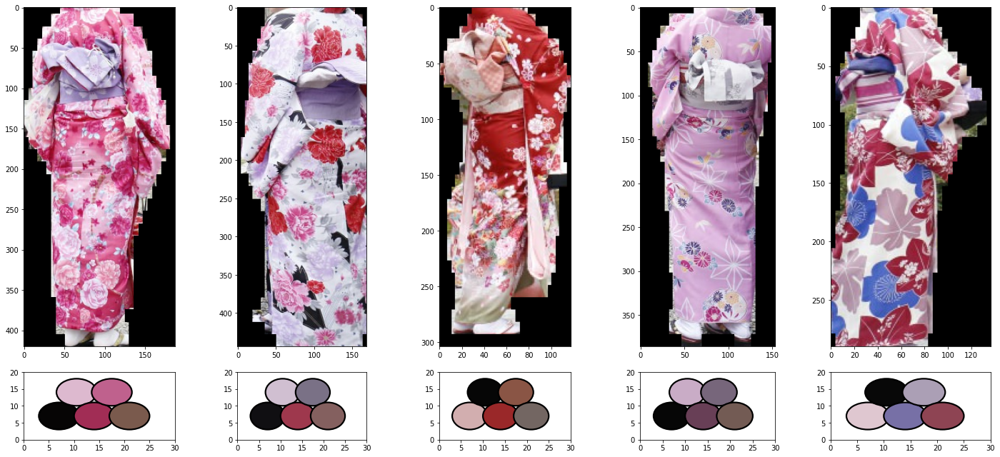

In [ ]:
visualize_dominant_colors(list_cuts_original, list_cuts_original_palette)

Note: this approach has the inconvenient that it includes black background pixels in the computation of dominant colors - yet we can't filter out the black because in some kimonos black is a dominant color.

### Second approach - cluster RGB colors using HDBSCAN

See https://hdbscan.readthedocs.io/en/latest/parameter_selection.html

In [ ]:
help(hdbscan.HDBSCAN.__init__)

Help on function __init__ in module hdbscan.hdbscan_:

__init__(self, min_cluster_size=5, min_samples=None, cluster_selection_epsilon=0.0, metric='euclidean', alpha=1.0, p=None, algorithm='best', leaf_size=40, memory=Memory(location=None), approx_min_span_tree=True, gen_min_span_tree=False, core_dist_n_jobs=4, cluster_selection_method='eom', allow_single_cluster=False, prediction_data=False, match_reference_implementation=False, **kwargs)
    Initialize self.  See help(type(self)) for accurate signature.



In [ ]:
def dominant_colors_per_kimono_v2(list_cuts_original, topn_colors = 5, debug_flag = False):
    """ for each kimono detected and contained in list_cuts_original, extract the pixels inside the polygon-contour
        and cluster these using HDBSCAN, finally taking the topn_colors clusters by number of member pixels"""


    list_cuts_original_palette = []

    for ii,dict_one_cut_original in enumerate(list_cuts_original):

        #First we want to take only the pixels inside the contour polygon (so that we don't include black background into processing)
        original_bbox = dict_one_cut_original["original_bbox"]
        h, w = original_bbox.shape[0], original_bbox.shape[1]
        #take away the top 1/6 of bbox height to focus on costume
        start_y = int(h/6)

        contour_polygon_ = dict_one_cut_original['contour_polygon']
        pixels_colors = []
        for i in range(start_y,h):
            for j in range(w):
                if cv2.pointPolygonTest(contour_polygon_,(i,j),True) <= 0:
                    if original_bbox[i][j].sum() != 0:
                        #except black
                        pixels_colors.append(original_bbox[i][j])  

        if debug_flag is True:
            print("{} pixels were found inside contour out of total {} pixels in bbox".format(len(pixels_colors), h * w)) 

        #now we have a list of rgb triplets for all pixels inside the contour
        arr_pixels_colors = np.array(pixels_colors, dtype = np.uint8)
        
        #adapt params based on number of items to cluster
        num_pixes =  arr_pixels_colors.shape[0]
        min_cluster_size = max(int( 0.0005 * num_pixes), 2)
        if debug_flag is True:
            print("HDBSCAN with min_cluster_size=", min_cluster_size)
        
        pixel_colors_clustering = hdbscan.HDBSCAN(min_cluster_size=min_cluster_size, min_samples = 2, gen_min_span_tree=True)
        pixel_colors_clustering.fit(arr_pixels_colors)

        pixels_labels = pixel_colors_clustering.labels_
        #NOTE some pixels were placed in cluster -1 , i.e. unlabelled
        if debug_flag is True:
            print("{} chromatic clusters were identified".format(np.unique(pixels_labels).shape[0] - 1))
        #for each cluster, compute the centroid
        list_color_clusters = []
        for color_cluster_id in np.unique(pixels_labels):
            #get the indices in the pixel_labels array where the currently analyzed color_cluster_id is found
            idx_label = np.where(pixels_labels==color_cluster_id)
            #get the cluster's member points
            member_pixels = arr_pixels_colors[idx_label]

            if color_cluster_id != -1:
                #color_cluster_centroid = np.array(member_pixels).mean(axis=0)  
                #instead of taking the mean, we take median in each channel (rgb)
                color_cluster_centroid = [np.median(member_pixels[:,0]), 
                                          np.median(member_pixels[:,1]), 
                                          np.median(member_pixels[:,2])]   
                #cast to int
                color_cluster_centroid = np.round(color_cluster_centroid, 0).astype(int)
                #from np array to list
                color_cluster_centroid_ = list(color_cluster_centroid)
                #print("color {} has {} member pixels and centroid: {}".format(color_cluster_id, len(member_pixels), color_cluster_centroid_))
                list_color_clusters.append({"cluster_centroid": color_cluster_centroid_,
                                            "num_members": len(member_pixels)})
            else:
                #the label -1 corresponds to "noise", items that weren't allocated to any cluster
                if debug_flag is True:
                    print("unallocated:", member_pixels.shape[0])


        #now choose topn_colors centroids based on highest number of cluster members
        sorted_list_color_clusters = sorted(list_color_clusters, key = lambda x: x["num_members"], reverse=True)
        color_palette = [el["cluster_centroid"] for el in sorted_list_color_clusters[0:topn_colors]]
    
        list_cuts_original_palette.append(color_palette)
        if debug_flag is True:
            print("---------------------------------------------------------------")

    return list_cuts_original_palette

In [ ]:
list_cuts_original_palette2 = dominant_colors_per_kimono_v2(list_cuts_original, topn_colors=5, debug_flag = True)
list_cuts_original_palette2

47995 pixels were found inside contour out of total 94061 pixels in bbox
HDBSCAN with min_cluster_size= 23
28 chromatic clusters were identified
unallocated: 8015
---------------------------------------------------------------
54843 pixels were found inside contour out of total 89908 pixels in bbox
HDBSCAN with min_cluster_size= 27
459 chromatic clusters were identified
unallocated: 16750
---------------------------------------------------------------
24555 pixels were found inside contour out of total 42952 pixels in bbox
HDBSCAN with min_cluster_size= 12
366 chromatic clusters were identified
unallocated: 11131
---------------------------------------------------------------
34669 pixels were found inside contour out of total 71302 pixels in bbox
HDBSCAN with min_cluster_size= 17
484 chromatic clusters were identified
unallocated: 13852
---------------------------------------------------------------
24585 pixels were found inside contour out of total 47539 pixels in bbox
HDBSCAN with 

[[[219, 168, 196], [51, 41, 41], [122, 24, 44], [88, 63, 98], [99, 19, 27]],
 [[174, 43, 56],
  [30, 29, 37],
  [211, 207, 229],
  [204, 202, 213],
  [216, 207, 232]],
 [[161, 28, 28],
  [206, 178, 177],
  [255, 234, 240],
  [230, 227, 227],
  [255, 245, 248]],
 [[217, 187, 218],
  [212, 198, 215],
  [158, 147, 157],
  [195, 147, 194],
  [219, 193, 223]],
 [[143, 42, 65],
  [234, 233, 232],
  [76, 97, 179],
  [234, 223, 223],
  [21, 22, 21]]]

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:19: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.


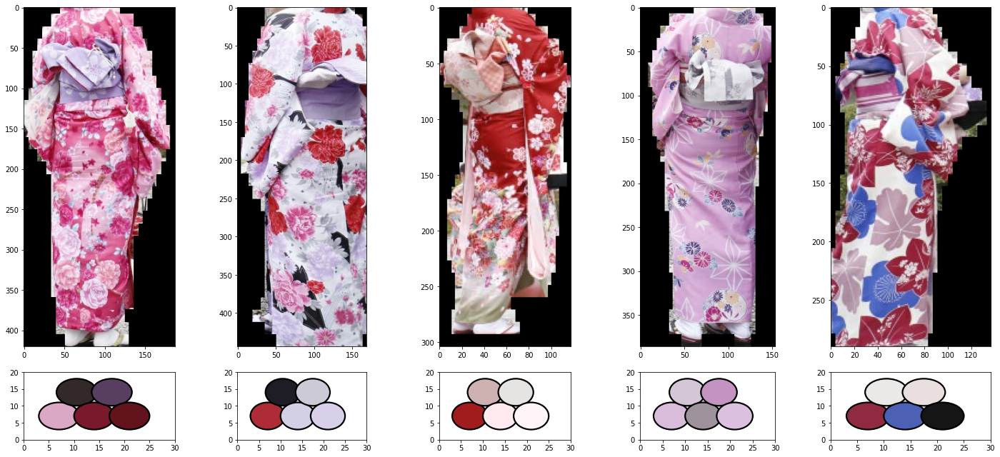

In [ ]:
visualize_dominant_colors(list_cuts_original, list_cuts_original_palette2)

## Summarize end-to-end pipeline and apply to various kimonos images

In [ ]:
def end2end_inference_postprocess_colors(img_filename, version_algo_dominantcolor = 1):
    """for the input img_filename, perform all steps from read, inference, post-processing and dominant color,
       where the latter is computed with our HDBSCAN-based implementation or using ColorThief"""
       
    res_mask_rcnn_confident, im1_arr = make_confident_prediction(img_filename)
    list_cuts_original = postprocess_inference_result(res_mask_rcnn_confident, im1_arr)
    if version_algo_dominantcolor == 1:
        list_cuts_original_palette = dominant_colors_per_kimono_v1(list_cuts_original)
    elif version_algo_dominantcolor == 2:
        list_cuts_original_palette = dominant_colors_per_kimono_v2(list_cuts_original)
    else:
        raise Exception("choose version_algo_dominantcolor to be 1 or 2")

    return list_cuts_original, list_cuts_original_palette, im1_arr

**ILLUSTRATION 1:**

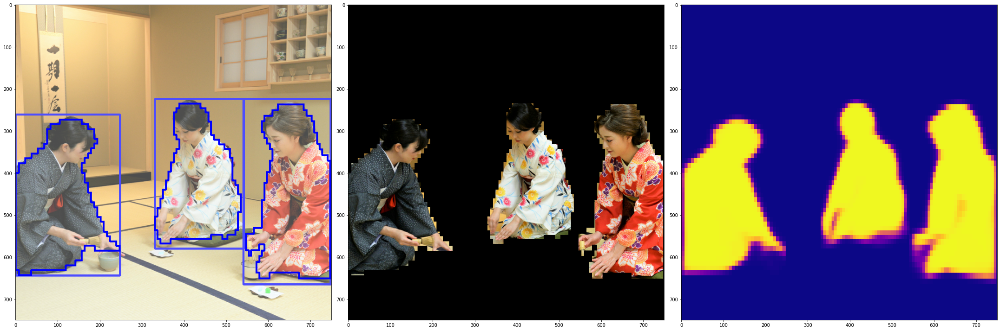

In [ ]:
list_cuts_original, list_cuts_original_palette, im1_arr = end2end_inference_postprocess_colors(img_filename = "kimono12.jpg",
                                                                                               version_algo_dominantcolor = 2)
debugged_visualization(list_cuts_original, im1_arr)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:19: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.


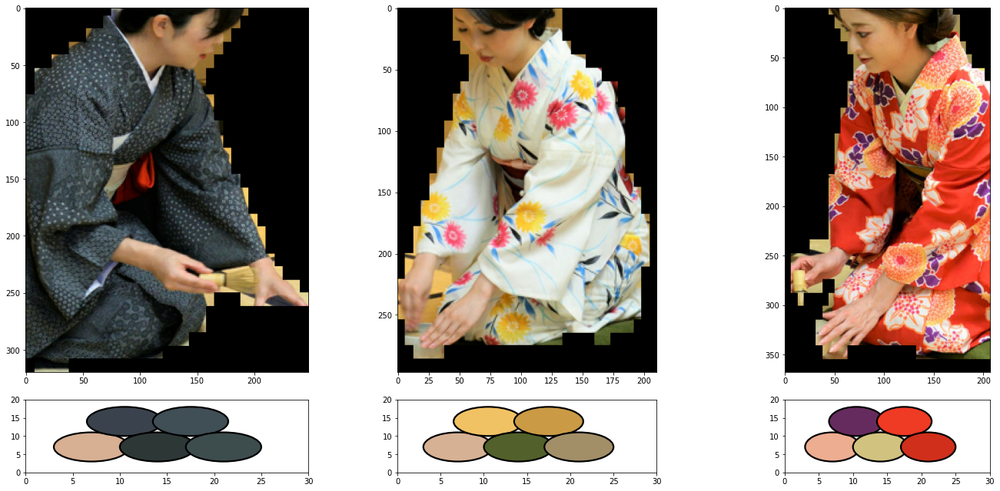

In [ ]:
visualize_dominant_colors(list_cuts_original, list_cuts_original_palette)

**ILLUSTRATION 2:**

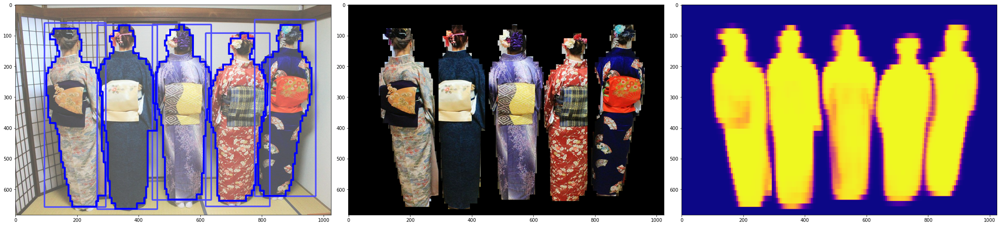

In [ ]:
list_cuts_original, list_cuts_original_palette, im1_arr = end2end_inference_postprocess_colors(img_filename = "kimono3.jpg",
                                                                                               version_algo_dominantcolor = 2)
debugged_visualization(list_cuts_original, im1_arr)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:19: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.


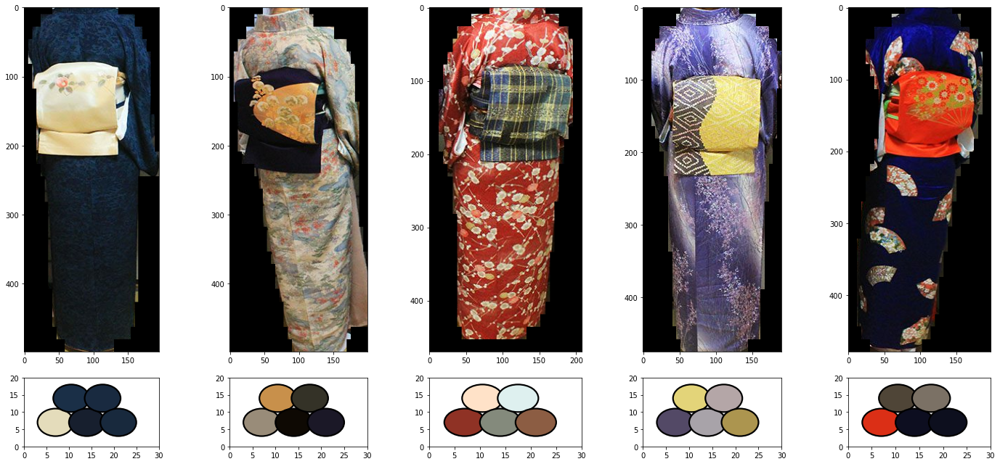

In [ ]:
visualize_dominant_colors(list_cuts_original, list_cuts_original_palette)

**ILLUSTRATION 3:**

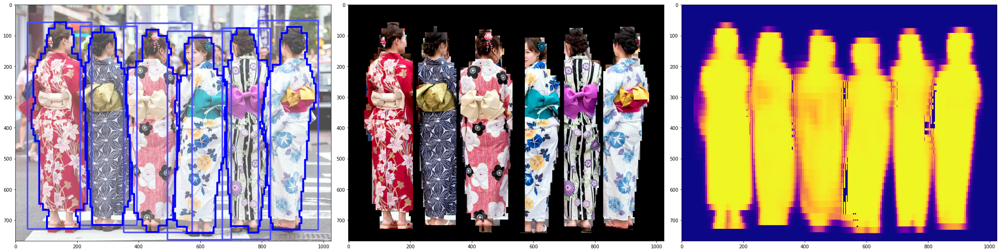

In [ ]:
list_cuts_original, list_cuts_original_palette, im1_arr = end2end_inference_postprocess_colors(img_filename = "kimono2.jpg",
                                                                                               version_algo_dominantcolor = 2)
debugged_visualization(list_cuts_original, im1_arr)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:19: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.


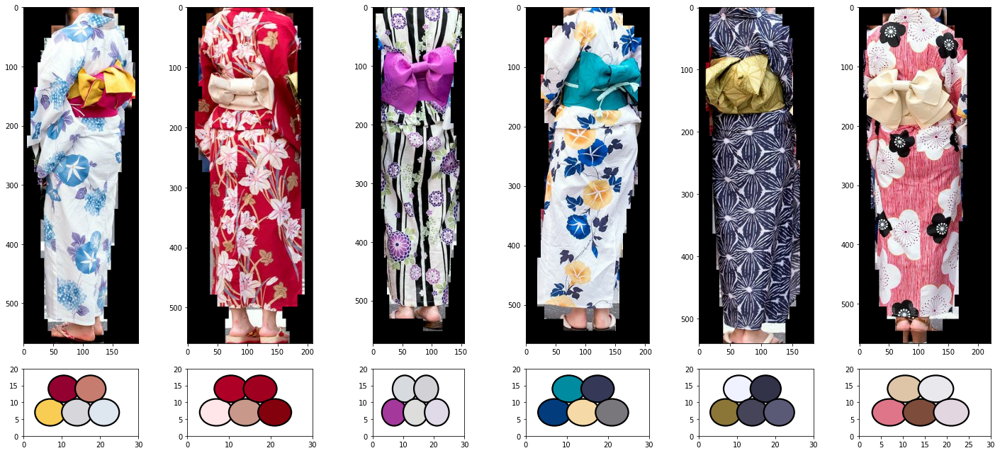

In [ ]:
visualize_dominant_colors(list_cuts_original, list_cuts_original_palette)

**ILLUSTRATION 4:**

Comment: the current as well as the following two illustrations are from a "Coming of Age" Ceremony (see https://en.wikipedia.org/wiki/Coming_of_Age_Day).

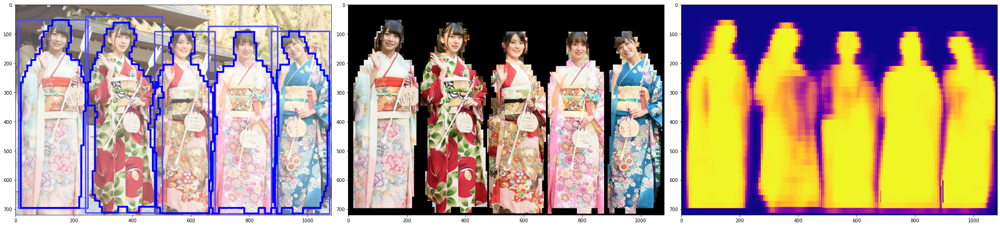

In [ ]:
list_cuts_original, list_cuts_original_palette, im1_arr = end2end_inference_postprocess_colors(img_filename = "kimono7.jpg",
                                                                                               version_algo_dominantcolor = 2)
debugged_visualization(list_cuts_original, im1_arr)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:19: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.


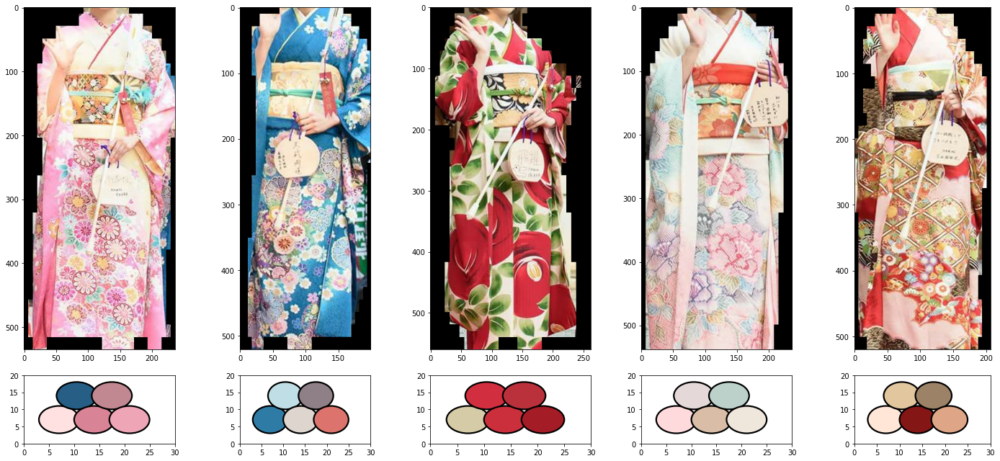

In [ ]:
visualize_dominant_colors(list_cuts_original, list_cuts_original_palette)

**ILLUSTRATION 5:**

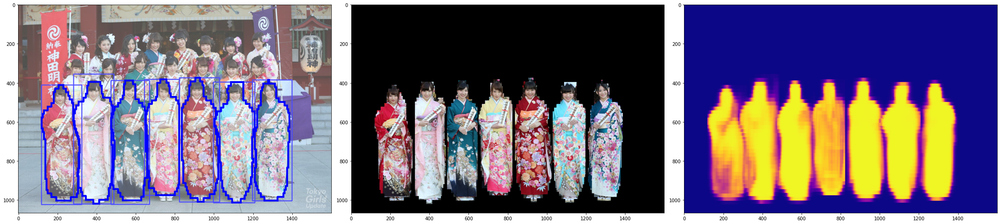

In [ ]:
list_cuts_original, list_cuts_original_palette, im1_arr = end2end_inference_postprocess_colors(img_filename = "kimono6.jpg",
                                                                                               version_algo_dominantcolor = 2)
debugged_visualization(list_cuts_original, im1_arr)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:19: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.


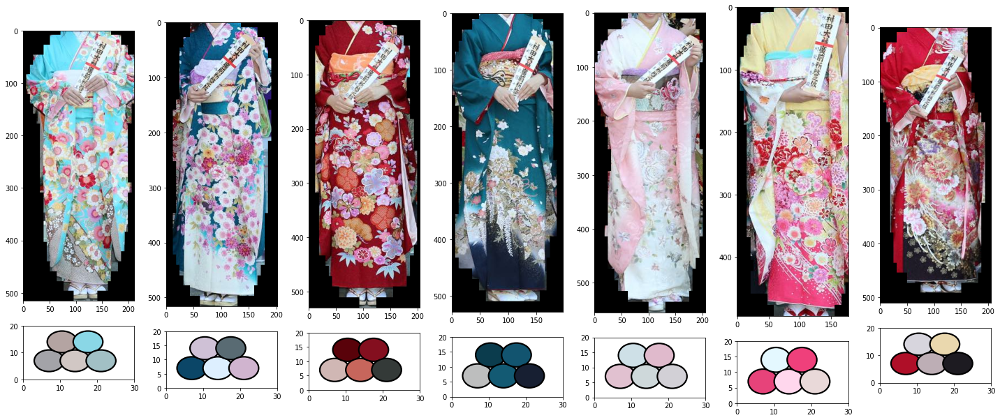

In [ ]:
visualize_dominant_colors(list_cuts_original, list_cuts_original_palette)

**ILLUSTRATION 6:**

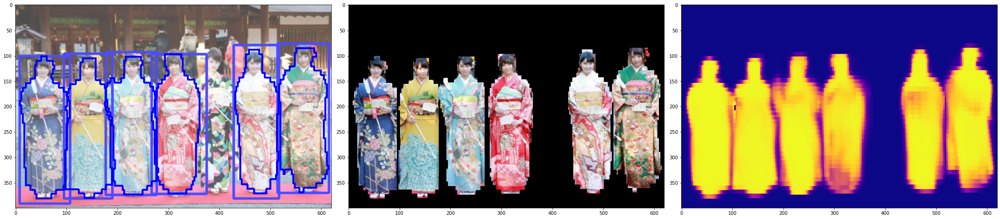

In [ ]:
list_cuts_original, list_cuts_original_palette, im1_arr = end2end_inference_postprocess_colors(img_filename = "kimono5.jpg",
                                                                                               version_algo_dominantcolor = 2)
debugged_visualization(list_cuts_original, im1_arr)

One entity is absent because it didn't pass the threshold of 0.5 set at instance level in make_confident_prediction, when calling filter_confident_results

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:19: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.


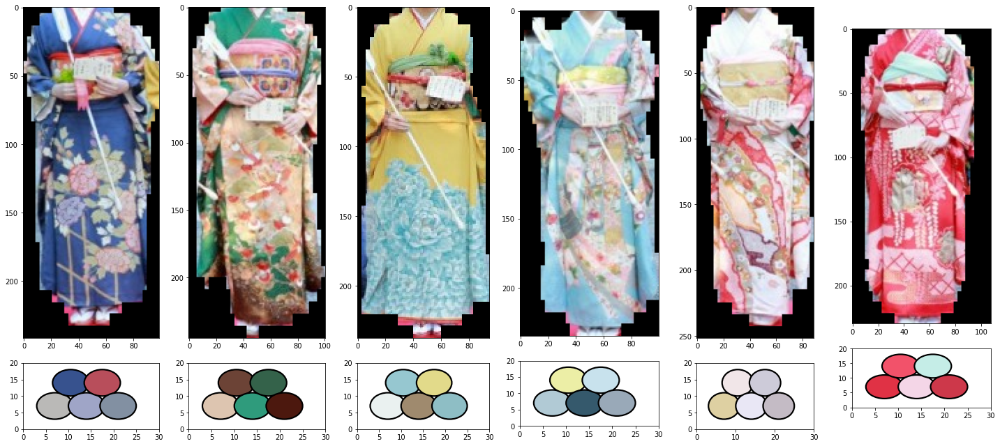

In [ ]:
visualize_dominant_colors(list_cuts_original, list_cuts_original_palette)

**ILLUSTRATION 7:**

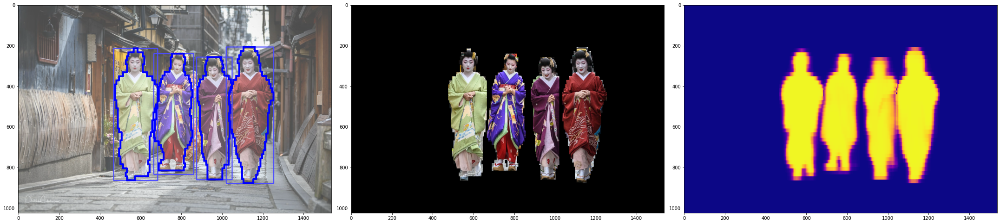

In [ ]:
list_cuts_original, list_cuts_original_palette, im1_arr = end2end_inference_postprocess_colors(img_filename = "kimono10.jpg",
                                                                                               version_algo_dominantcolor = 2)
debugged_visualization(list_cuts_original, im1_arr)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:19: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.


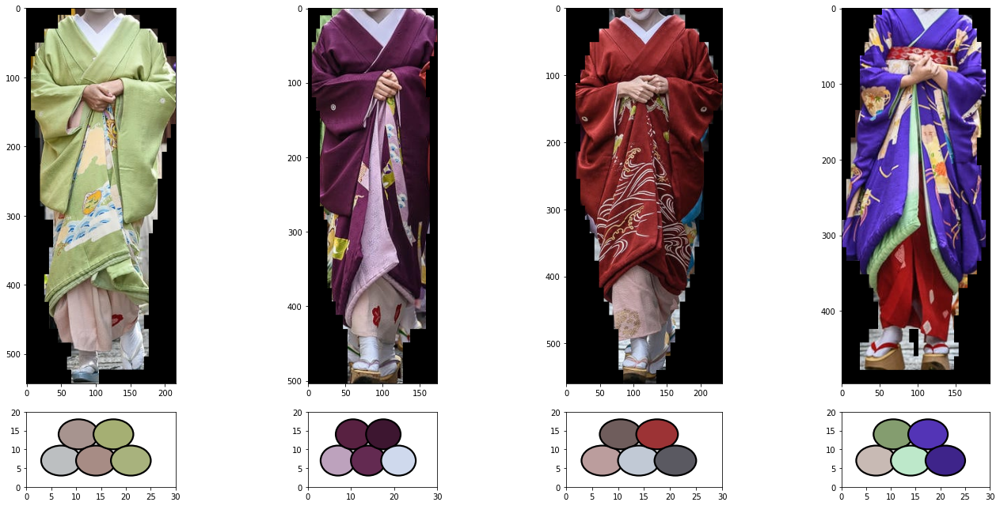

In [ ]:
visualize_dominant_colors(list_cuts_original, list_cuts_original_palette)

**ILLUSTRATION 8:**

Comment: the current as well as the following two illustrations are from cultural performances, including Kitano Odori, Kyo Odori, Miyako Odori and Kamogawa Odori.  

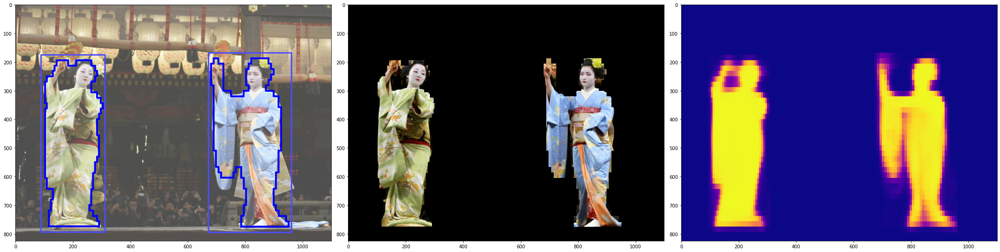

In [ ]:
list_cuts_original, list_cuts_original_palette, im1_arr = end2end_inference_postprocess_colors(img_filename = "kimono11.jpg",
                                                                                               version_algo_dominantcolor = 2)
debugged_visualization(list_cuts_original, im1_arr)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:19: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.


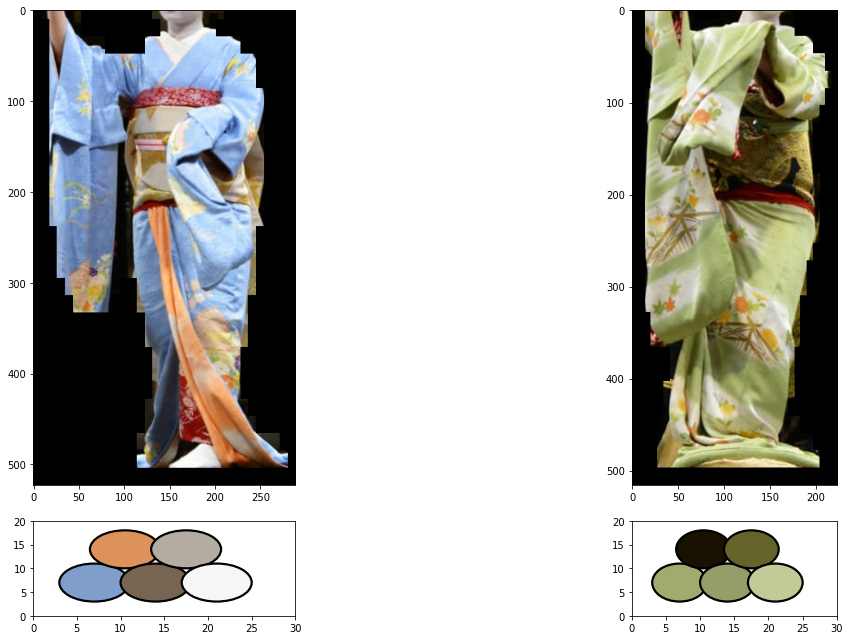

In [ ]:
visualize_dominant_colors(list_cuts_original, list_cuts_original_palette)

**ILLUSTRATION 9:**

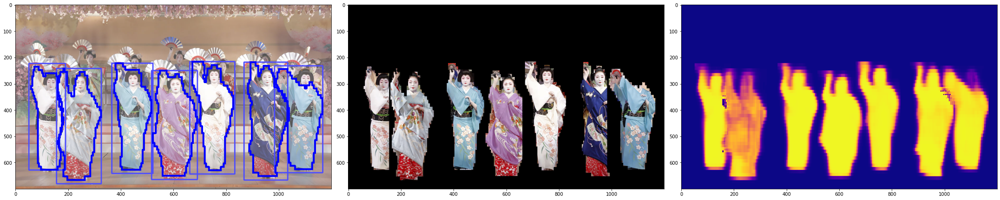

In [ ]:
list_cuts_original, list_cuts_original_palette, im1_arr = end2end_inference_postprocess_colors(img_filename = "kimono8.jpg",
                                                                                               version_algo_dominantcolor = 2)
debugged_visualization(list_cuts_original, im1_arr)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:19: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.


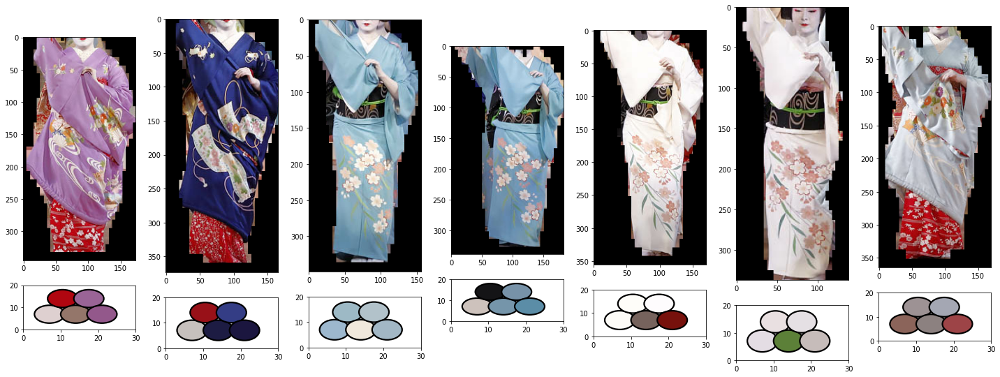

In [ ]:
visualize_dominant_colors(list_cuts_original, list_cuts_original_palette)

**ILLUSTRATION 10:**

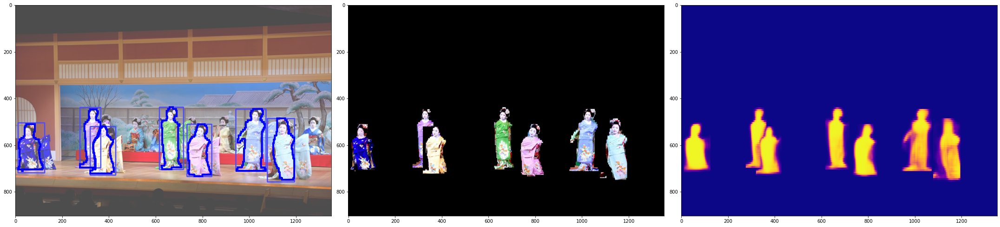

In [ ]:
list_cuts_original, list_cuts_original_palette, im1_arr = end2end_inference_postprocess_colors(img_filename = "kimono9.jpg",
                                                                                               version_algo_dominantcolor = 2)
debugged_visualization(list_cuts_original, im1_arr)

Remember, we get only these results because we set size threshold on bbox to have at least half of the original image height

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:19: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.


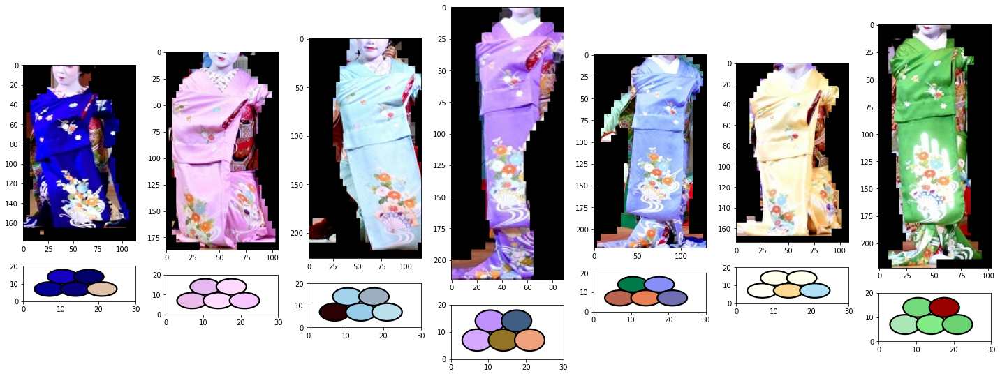

In [ ]:
visualize_dominant_colors(list_cuts_original, list_cuts_original_palette)